# Creating Panoramas from Video with OpenCV

In [1]:
import cv2
from anutils import data_path
from anutils.cv import rect, transform, joining
import numpy as np
from IPython.display import display, Video
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from itertools import combinations
from math import comb

# Configuration
fa, fb = figscale = (7, 2)
plt.rcParams['text.usetex'] = True
plt.rcParams['font.size'] = 20
plt.rcParams['figure.figsize'] = (4 * fa // fb, 3 * fa // fb)
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['xtick.bottom'] = False
plt.rcParams['xtick.labelbottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.labelleft'] = False
np.set_printoptions(precision=2)

def disp_img(image):
    rgbim = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgbim)
    plt.show()

def disp_kps(image, keypoints):
    d_img = image.copy()
    cv2.drawKeypoints(d_img, keypoints, d_img)
    disp_img(d_img)
    del d_img

def disp_mtc(img1, kps1, img0, kps0, matches01):
    d_img = cv2.drawMatches(img1, kps1, img0, kps0, 
                            matches01, None, 
                            flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
    disp_img(d_img)
    del d_img

Video(str(data_path / 'image-stitching-example.mp4'), embed=True, height=500)

First extract frames from video

In [2]:
%%bash
dos2unix << 'EOF' > tmp.sh
# Variables
FRAMES_DIR=frames
EXTENSION=png
START_TIME=1.5
FRAME_RATE=0.5

# To data directory
pushd ../../data

# Reset frame directory
if [ -d $FRAMES_DIR ]; then
    rm -f $FRAMES_DIR/*
else
    mkdir $FRAMES_DIR
fi

# Extract frames from video
ffmpeg -i image-stitching-example.mp4 -ss $START_TIME -r $FRAME_RATE $FRAMES_DIR/image-stitching-example-%02d.$EXTENSION 2>&1

# Remove first frame
rm $FRAMES_DIR/image-stitching-example-01.$EXTENSION

popd
EOF
bash tmp.sh

/mnt/c/Users/akans/Documents/Projects/andys-notebook/data /mnt/c/Users/akans/Documents/Projects/andys-notebook/notebooks/image-processing-and-computer-vision
ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enabl

Load our frame files into memory

In [6]:
frames_directory = data_path / 'frames'
frame_files = list(frames_directory.glob('*.png'))
n_frames = len(frame_files)
frame_imgs = [cv2.imread(file) for file in tqdm(frame_files, desc='Reading images', total=n_frames)]

Reading images:   0%|          | 0/8 [00:00<?, ?it/s]

Our goal would be to recreate OpenCV's stitching algorithm for panoramas. Here's it in action with the frames we've extracted

Stitch using 8 images


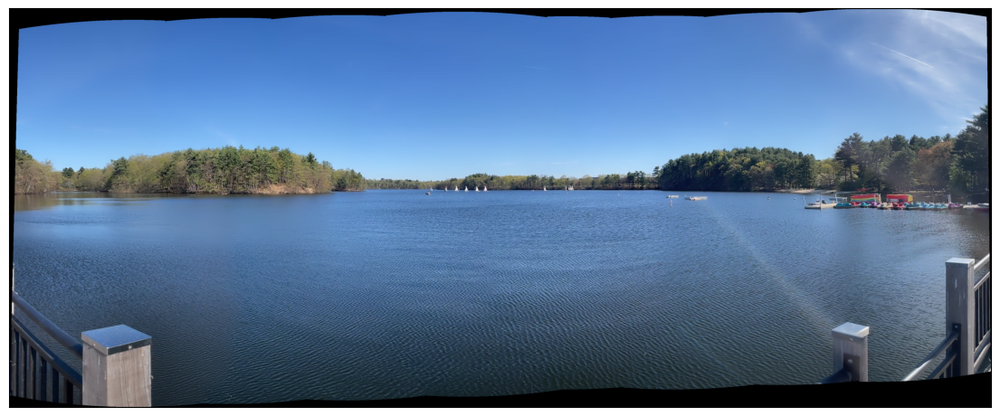

In [8]:
# Create stitcher
stitcher = cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
print('Stitch using %d images' % len(frame_imgs))
status, pano = stitcher.stitch(frame_imgs)

if status != cv2.Stitcher_OK:
    raise Exception('Something went wrong with stitching! Error code: %d' % status)

disp_img(pano)

# Find image transformations 

We first use SIFT to find trackable features in each image. We then detect features in an adjacent image and match them with ours. Finally, we use these matches to estimate what kind of transformation we'd need to do to the second image in order for it to match the first one

Reading images:   0%|          | 0/8 [00:00<?, ?it/s]

Detecting keypoints:   0%|          | 0/8 [00:00<?, ?it/s]

Calculating matches:   0%|          | 0/7 [00:00<?, ?it/s]

Calculated homographies


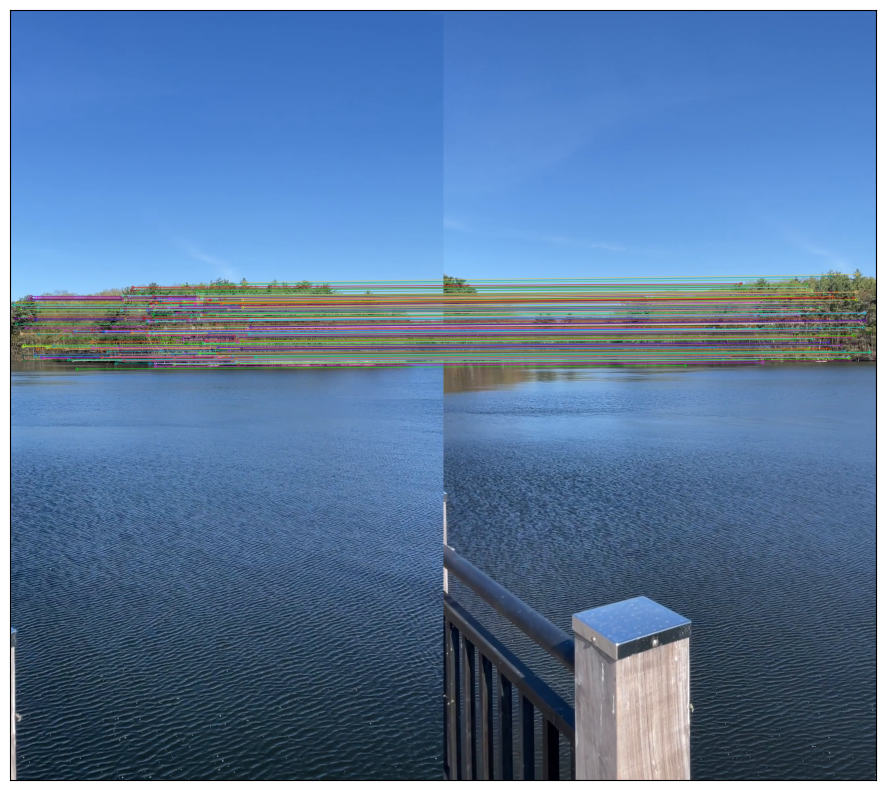

[[ 7.96e-01 -1.40e-02  4.63e+02]
 [-1.71e-01  9.38e-01  4.60e+01]
 [-1.89e-04 -2.04e-06  1.00e+00]]


In [5]:
# Create SIFT detector and BF matcher
sift = cv2.SIFT.create()
matcher = cv2.BFMatcher()

def match_with_ratio_test(trg_dsc, src_dsc, ratio_threshold=0.45):
    match_groups = matcher.knnMatch(trg_dsc, src_dsc, k=2)
    positive_b = [ m for m in match_groups if m[0].distance > 0 ]
    return [ a for a,b in positive_b if a.distance/b.distance < ratio_threshold ]

def homography_from_matches(trg_kps, src_kps, mtcs, reproj_threshold=7):
    """ """
    dst_points = np.array([ src_kps[m.trainIdx].pt for m in mtcs ])
    src_points = np.array([ trg_kps[m.queryIdx].pt for m in mtcs ])
    M,_ = cv2.findHomography(src_points, dst_points, cv2.RANSAC, reproj_threshold)
    return M


# Find keypoints and matches
frame_kps = [
    sift.detectAndCompute(img, None)
    for img in tqdm(frame_imgs, desc='Detecting keypoints', total=n_frames)
]
match_idxs = np.array([ np.arange(n_frames-1), np.arange(1,n_frames) ], dtype=np.int32).T
matches = [
    ( idx_a, idx_b, match_with_ratio_test(frame_kps[idx_b][1], frame_kps[idx_a][1], 0.45) )
    for idx_a,idx_b in tqdm(match_idxs, desc='Calculating matches', total=(n_frames - 1)) 
]

homographies = [
    ( idx_a, idx_b, homography_from_matches(frame_kps[idx_b][0], frame_kps[idx_a][0], mtcs) )
    for idx_a, idx_b, mtcs in matches
]
print('Calculated homographies')

# Display sample
idx0,idx1,match10 = matches[0]
img0 = frame_imgs[idx0]
kps0 = frame_kps[idx0][0]
img1 = frame_imgs[idx1]
kps1 = frame_kps[idx1][0]
disp_mtc(img1, kps1, img0, kps0, match10)
print(homographies[0][2])

However, we are _not_ going to use these to tranform images and stitch them together. The only reason we're creating these homographies is to estimate the camera's relative position when it took each of these frames. Knowing that, we can correct for each of these transformations in every image _before_ applying the transformation and stitching.

We'll that our center point is at the center of the image (what should be $\left<0, 0\right>$). All in all, we're only focused on finding the focal length $f$. To do this, we decompose our homographies into a projection $F$ (with the focal length) and a rotation $R$. We assume that no translating was done when the panorama was taken, so our transformation $R$ is strictly rotation.

$$
F = \begin{bmatrix}
f & 0 & 0 \\
0 & f & 0 \\
0 & 0 & 1
\end{bmatrix}
\quad R \in SO(3)
$$
Our homography $H$ should the equivalent to undistorting an image, rotating it, then distorting it back: $H = FRF^{-1}$. So, for each homography, we calculate $F^{-1}HF = R$ and determine which of these contains the best focal length. We don't know $R$ but we'll use one fact about $R$ to our advantage. First off $R^TR = I$, meaning all columns are normalized and orthogonal to each other. Since $R = F^{-1}HF$ and we know $H$, we can use this to find $F$.

With our substitution we discover we're trying to solve the following:

$$
(F^{-1}HF)^T(F^{-1}HF) = I
$$

We expand the transpose

$$
F^TH^T\left(F^{-1}\right)^T F^{-1} H F = I
$$

Move the left and right $F$ matrices using their inverses over to the right hand side of the equation

$$
\left(F^{-1}\right)^T F^T H^T\left(F^{-1}\right)^T F^{-1} H F F^{-1} = \left(F^{-1}\right)^T I F^{-1} \rightarrow H^T\left(F^{-1}\right)^T F^{-1} H = \left(F^{-1}\right)^T F^{-1}
$$

We simplify $\left(F^{-1}\right)^T F^{-1}$ to a new matrix $B$ to make this easier

$$
H^TBH = B
$$

OpenCV has a stitcher class that can do the stitching for us! Let's see what it comes up with.

I also took a true panorama of the same scene with my iPhone for a comparision. This is what it looks like

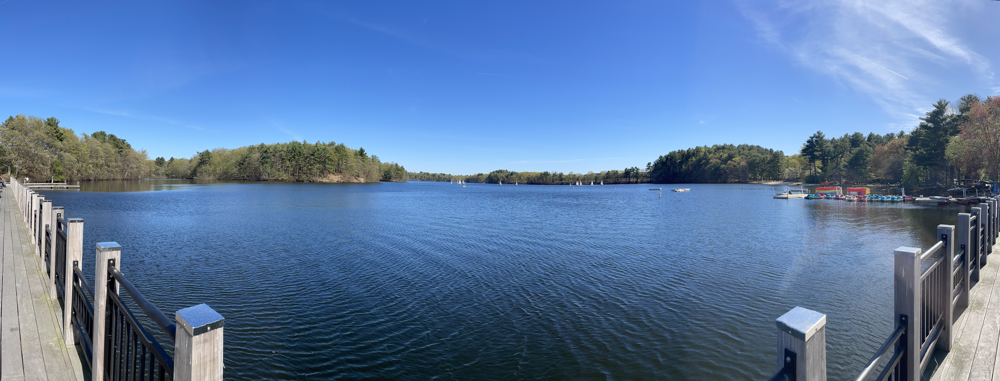